## Notebook to plot images for figure 2 for MICCAI submission

### create examples predictions on patients


In [ ]:
import meld_graph.experiment
import os
import numpy as np
import h5py
import matplotlib_surface_plotting as msp
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import nibabel as nb
from meld_classifier.paths import BASE_PATH
from meld_classifier.meld_cohort import MeldCohort,MeldSubject
def load_prediction(subject,hdf5,dset='prediction'):
    results={}
    with h5py.File(hdf5, "r") as f:
        for hemi in ['lh','rh']:
            results[hemi] = f[subject][hemi][dset][:]
    return results


In [16]:
model_graph = '/rds/project/kw350/rds-kw350-meld/experiments_graph/kw350/23-02-23_HKOJ_finetuning_distance_classification_mask/s_2'
model_pervertex = '/rds/project/kw350/rds-kw350-meld/experiments/co-ripa1/iteration_21-09-15_nothresh/ensemble_21-09-15'

In [17]:
cohort = MeldCohort(hdf5_file_root='{site_code}_{group}_featurematrix_combat_6.hdf5',
               dataset='MELD_dataset_V6.csv')


In [24]:
folds = np.arange(5)

save_dirs = {
    'model_graph': [os.path.join(model_graph,f'fold_0{fold}', 'results') for fold in np.arange(5)] ,
    # 'model_pervertex': [os.path.join(model_pervertex,f'fold_0{fold}', 'results') for fold in np.arange(10)] ,
    
}

In [19]:
# n_vert = len(cohort.cortex_label)*2

In [44]:
with h5py.File(os.path.join(save_dirs['model_graph'][0], 'predictions.hdf5'), "r") as f:
    subjects_test = list(f.keys())


In [25]:
import matplotlib_surface_plotting as msp
def load_predictions_for_subject(subj,savedirs,
        cohort,):
    #load mask
    s = MeldSubject(subj,cohort=cohort)
    hemi=s.get_lesion_hemisphere()
    dists, label = s.load_feature_lesion_data(
                    features=['.on_lh.boundary_zone.mgh'], hemi=hemi, features_to_ignore=[]
                )
    seg_pred = np.zeros(len(cohort.cortex_mask))
    dist_pred = np.zeros(len(cohort.cortex_mask))
    n_folds = 5
    folds = np.arange(n_folds)
    dp=[]
    sp = []
    for fold in folds:
        save_dir = save_dirs['model_graph'][fold]
        pred_file = os.path.join(save_dir, 'predictions.hdf5')
        result_hemis = load_prediction(subj,pred_file, dset='prediction')
        seg_pred[cohort.cortex_mask] += result_hemis[hemi]/n_folds
        distance_map = load_prediction(subj,pred_file, dset='distance_map')
        dist_pred[cohort.cortex_mask] += distance_map[hemi]/n_folds
        dp.append(distance_map[hemi])
        sp.append(result_hemis[hemi])
    file = os.path.join(model_pervertex,f'fold_all', 'results', 'predictions_ensemble_iteration_0.hdf5')
    per_vertex = np.zeros(len(cohort.cortex_mask))
    per_vertex[cohort.cortex_mask] = load_prediction(subj,file, dset='prediction')[hemi]
    print(np.sum(np.logical_and(seg_pred>0.09,label>0)))
    return label,seg_pred,dist_pred,per_vertex,dp,sp
    

In [33]:
from meld_classifier.meld_plotting import trim
from PIL import Image


In [49]:
subjects_test[400:-1]

['MELD_H4_3T_FCD_0015',
 'MELD_H4_3T_FCD_0016',
 'MELD_H4_3T_FCD_0031',
 'MELD_H4_3T_FCD_0038',
 'MELD_H4_3T_FCD_0040',
 'MELD_H5_3T_C_0001',
 'MELD_H5_3T_C_0002',
 'MELD_H5_3T_C_0004',
 'MELD_H5_3T_C_0006',
 'MELD_H5_3T_C_0007',
 'MELD_H5_3T_C_0009',
 'MELD_H5_3T_C_0010',
 'MELD_H5_3T_C_0011',
 'MELD_H5_3T_C_0012',
 'MELD_H5_3T_C_0014',
 'MELD_H5_3T_C_0015',
 'MELD_H5_3T_C_0016',
 'MELD_H5_3T_C_0017',
 'MELD_H5_3T_C_0018',
 'MELD_H5_3T_C_0019',
 'MELD_H5_3T_C_0021',
 'MELD_H5_3T_C_0025',
 'MELD_H5_3T_C_0027',
 'MELD_H5_3T_C_0029',
 'MELD_H5_3T_FCD_0001',
 'MELD_H5_3T_FCD_0004',
 'MELD_H5_3T_FCD_0005',
 'MELD_H5_3T_FCD_0007',
 'MELD_H5_3T_FCD_0011',
 'MELD_H5_3T_FCD_0014',
 'MELD_H5_3T_FCD_0015',
 'MELD_H5_3T_FCD_0017',
 'MELD_H5_3T_FCD_0020',
 'MELD_H5_3T_FCD_0021',
 'MELD_H5_3T_FCD_0022',
 'MELD_H5_3T_FCD_0024',
 'MELD_H5_3T_FCD_0026',
 'MELD_H5_3T_FCD_0029',
 'MELD_H6_3T_FCD_0004',
 'MELD_H6_3T_FCD_0005',
 'MELD_H6_3T_FCD_0006',
 'MELD_H6_3T_FCD_0009',
 'MELD_H6_3T_FCD_0011',
 'MELD

In [50]:
# initialise subjects
subjects=[
       
#        'MELD_H10_3T_FCD_0002', # good example prediction found
#         'MELD_H14_3T_FCD_0011', # good example prediction found
#         'MELD_H14_3T_FCD_0035', # good example prediction found
        'MELD_H10_3T_FCD_0014',
        'MELD_H4_3T_FCD_0015', # good example prediction not found, but remove FPs
        'MELD_H4_3T_FCD_0016', # good example prediction found, remove FPs
        'MELD_H4_3T_FCD_0031', # bad example where per-vertex do better
        'MELD_H4_3T_FCD_0040', # good example prediction found, remove FPs

        ]
#tested but not good
# 'MELD_H4_3T_FCD_0038', cannot see well predictions
 # 'MELD_H9_3T_FCD_0010',
 # 'MELD2_H7_3T_FCD_001',
 # 'MELD_H10_3T_FCD_0013'


0
0


/home/co-ripa1/.conda/envs/meld_graph/lib/python3.9/site-packages/matplotlib_surface_plotting/matplotlib_surface_plotting.py:323: RuntimeWarning: invalid value encountered in true_divide
  colours = (colours - colours.min())/(colours.max()-colours.min())


583
3675


/home/co-ripa1/.conda/envs/meld_graph/lib/python3.9/site-packages/matplotlib_surface_plotting/matplotlib_surface_plotting.py:306: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(base_size*len(rotate)+colorbar*(base_size-2),


5097
107


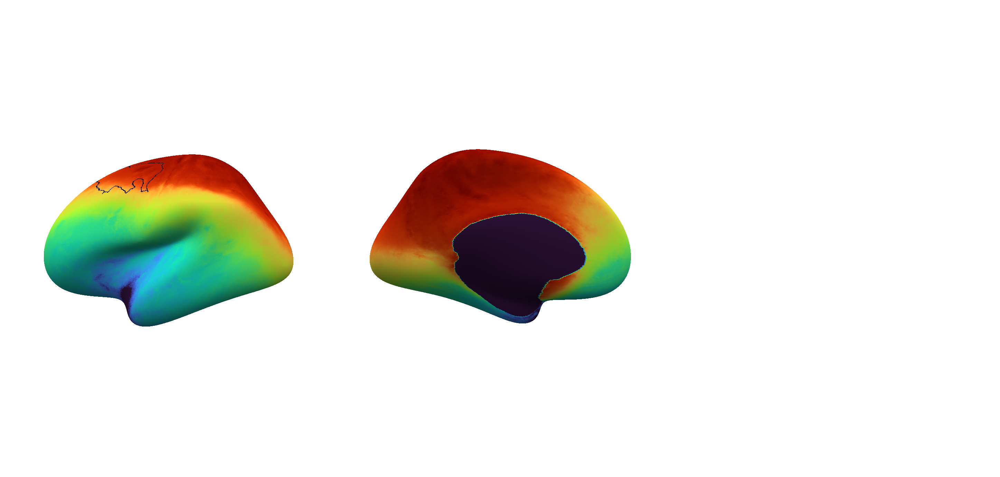

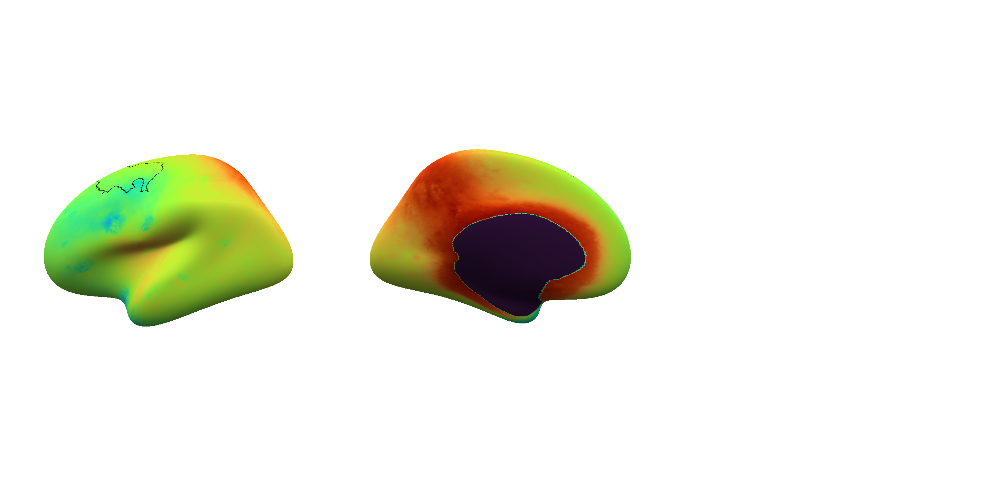

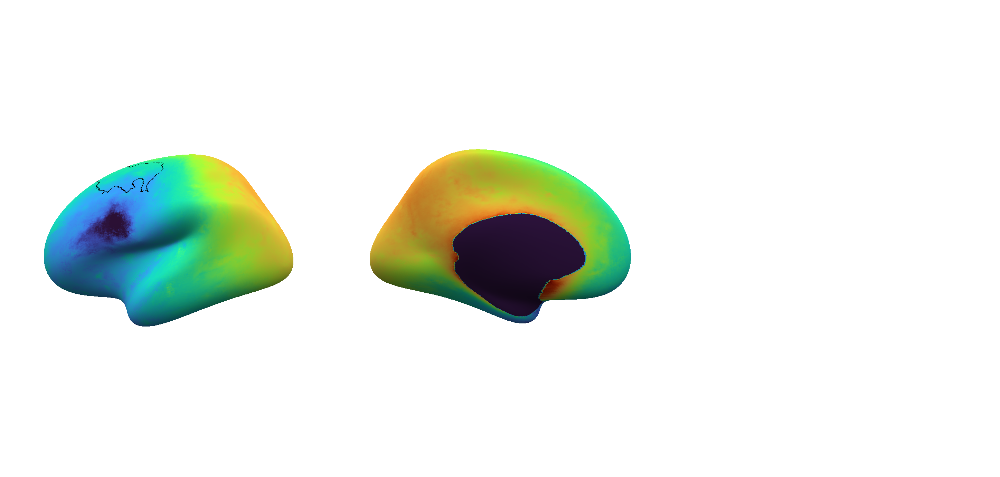

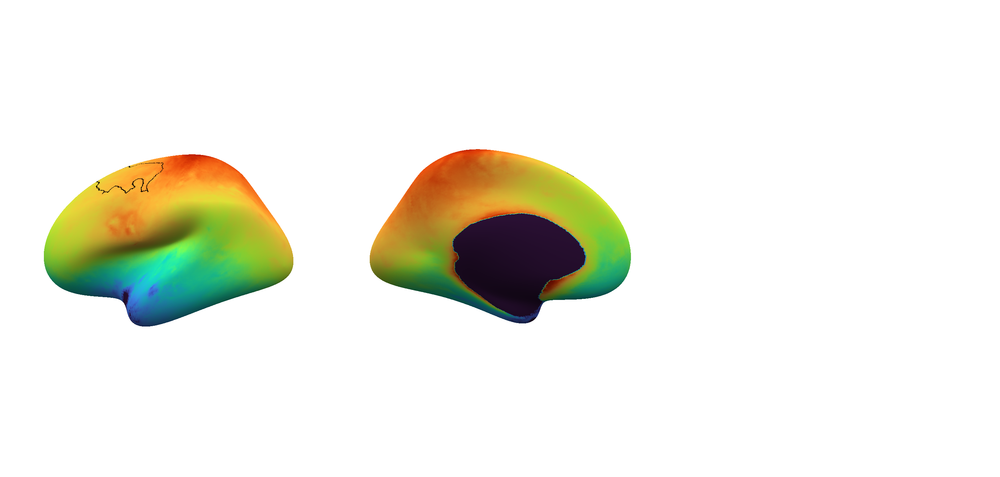

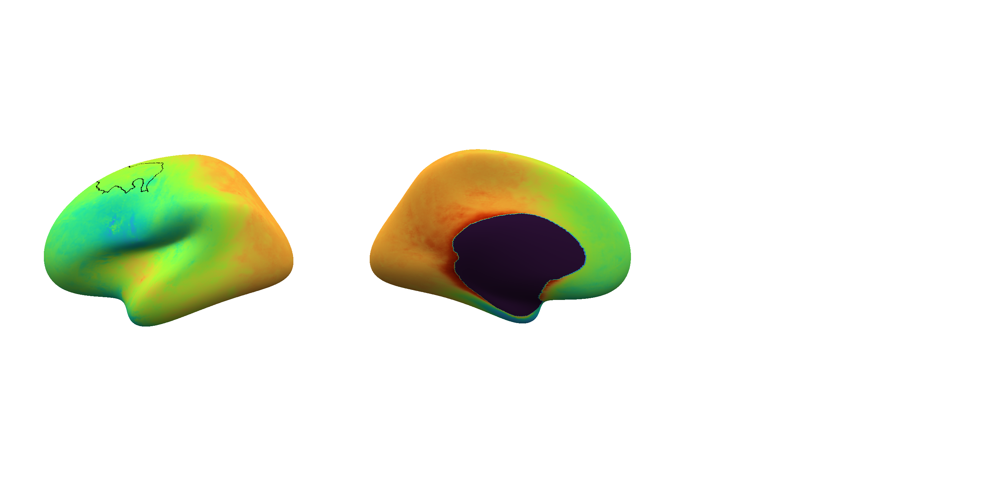

...

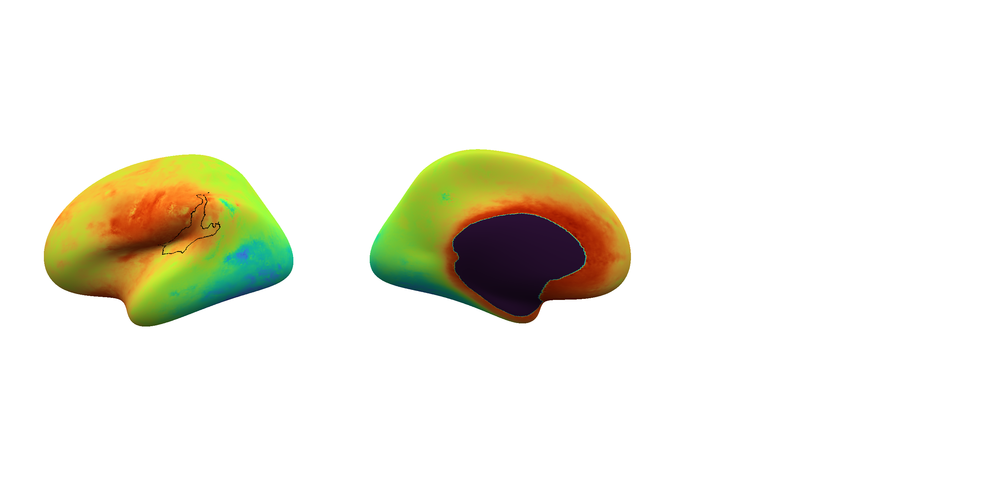

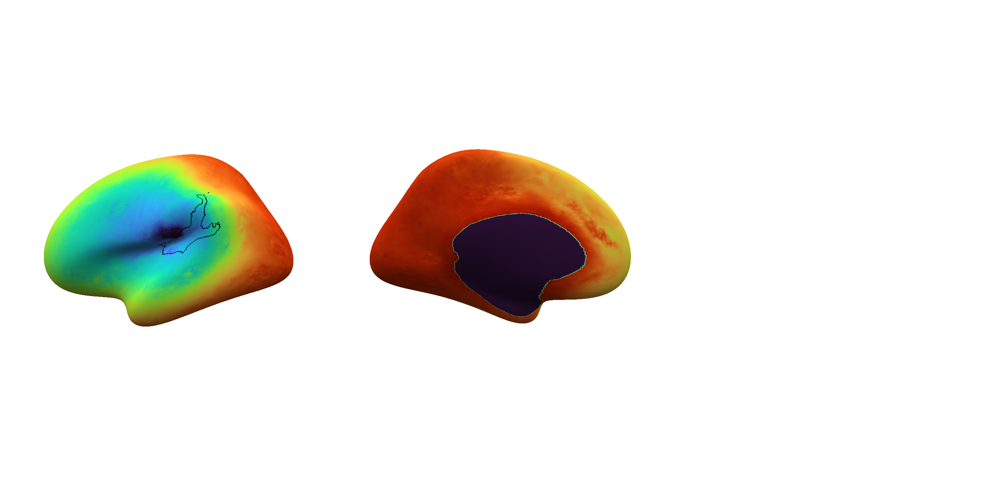

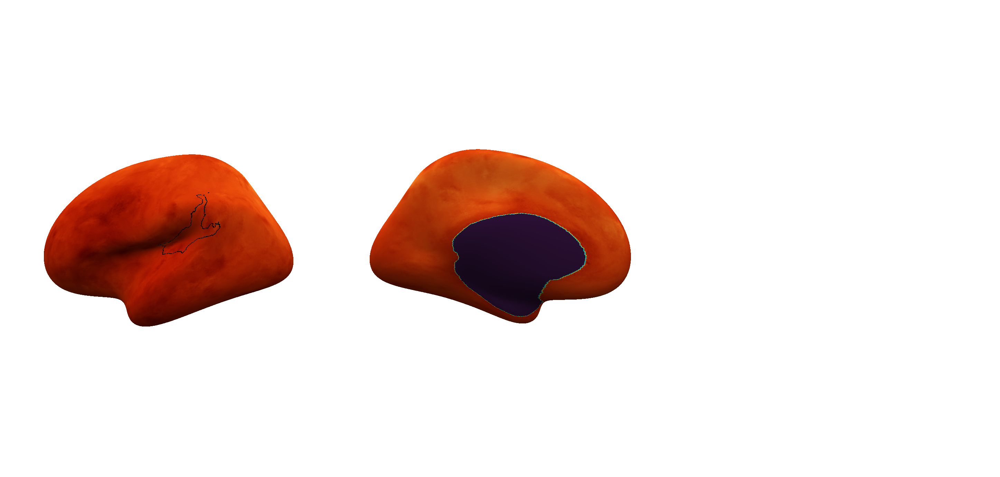

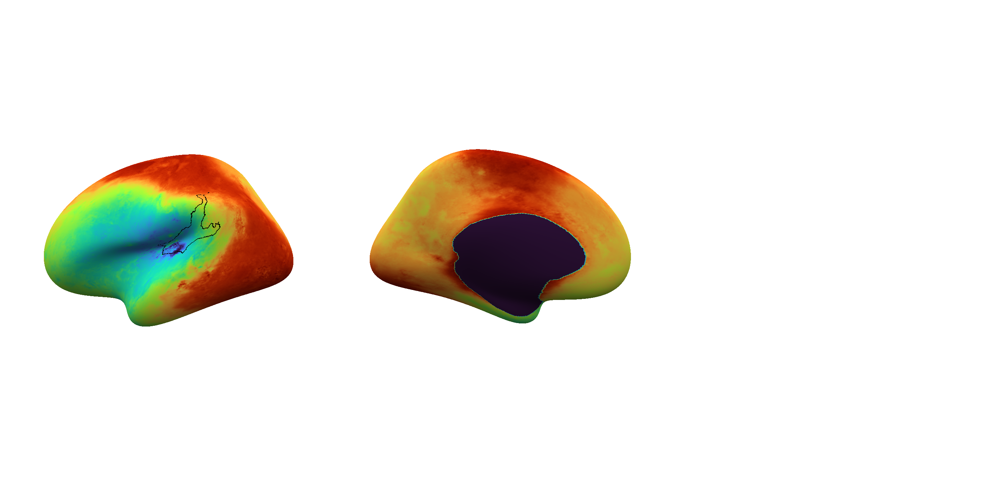

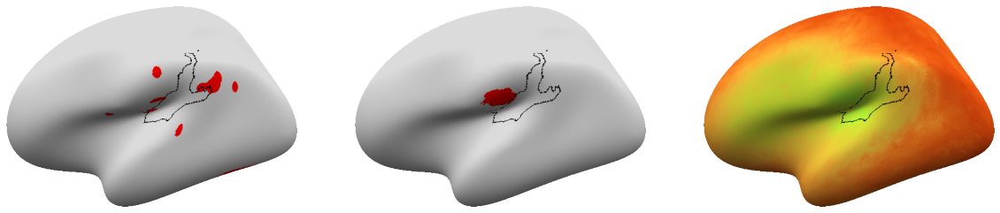

In [51]:
for subj in subjects:
    # get predictions and distance maps
    label,seg_pred,dist_pred,per_vertex,dp,sp = load_predictions_for_subject(subj,save_dirs,cohort)

    # ensemble distance maps
    for d in dp:
        full_map = np.zeros(len(cohort.cortex_mask))
        full_map[cohort.cortex_mask]=d
        msp.plot_surf(cohort.surf['coords'],cohort.surf['faces'],full_map,#rotate=[90],
    cmap='turbo',
    base_size = 20,filename='tmp1.png', colorbar=False,#mask=~per_vertex,
    parcel=label,parcel_cmap={0:[0,0,0,1],1:[0,0,0,1]})

    #plot predictions using per-vertex graph
    per_vertex = per_vertex>0
    msp.plot_surf(cohort.surf['coords'],cohort.surf['faces'],per_vertex,rotate=[90],
    cmap='bwr',
    base_size = 20,filename='tmp1.png', colorbar=False,mask=~per_vertex,
    parcel=label,parcel_cmap={0:[0,0,0,1],1:[0,0,0,1]})
    plt.close()
    im = Image.open('tmp1.png')
    trimmed_pv = trim(im)

    #plot predictions new graph and distance
    seg_pred = seg_pred>0.09
    msp.plot_surf(cohort.surf['coords'],cohort.surf['faces'],seg_pred,rotate=[90],
    cmap='bwr',
    base_size = 20,filename='tmp1.png', colorbar=False,mask=~seg_pred,
    parcel=label,parcel_cmap={0:[0,0,0,1],1:[0,0,0,1]})
    plt.close()
    im = Image.open('tmp1.png')
    trimmed_graph = trim(im)
    msp.plot_surf(cohort.surf['coords'],cohort.surf['faces'],dist_pred,rotate=[90],
    cmap='turbo',
    base_size = 20,filename='tmp1.png', colorbar=False,#mask=~per_vertex,
    parcel=label,parcel_cmap={0:[0,0,0,1],1:[0,0,0,1]})
    plt.close()
    im = Image.open('tmp1.png')
    trimmed_dist = trim(im)

    #combine plots
    fig,ax = plt.subplots(1,3,figsize=(20,10))
    ax[0].imshow(trimmed_pv)
    ax[1].imshow(trimmed_graph)
    ax[2].imshow(trimmed_dist)
    for ax in ax:
        ax.axis('off')

    #save plot
    plt.savefig(f'/rds/project/kw350/rds-kw350-meld/experiments_graph/co-ripa1/23-02-10_images_MICCAI/examples_patients_fullmodel_{subj}.png', transparent=True)

